In [3]:
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px
from skimage import exposure
import segmentflow.segment as sf

Run Segmentflow on the sample IDOX_EstaneNP

# Identify crop location

In [4]:
#-------------#
# Load images #
#-------------#
imgs = sf.load_images(
    r'../data/IDOX_EstaneNP/IDOX_EstaneNP_AHE',
    slice_crop=None,
    row_crop=None,
    col_crop=None,
    convert_to_float=True,
    file_suffix='.tiff'
)

Loading images...
--> Images loaded as 3D array:  (1012, 1024, 1004)


Plotting images: [100, 450, 800]


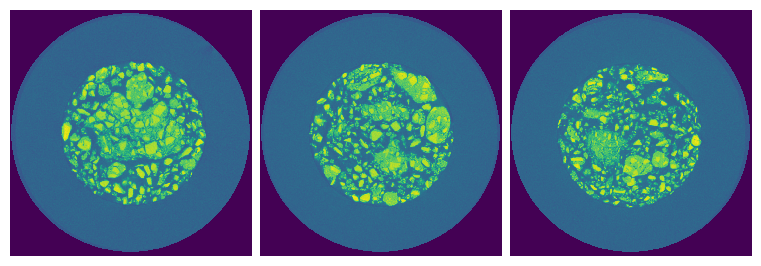

In [5]:
slices = [100, 450, 800]
fig, axes = sf.plot_imgs(
    imgs,
    # n_imgs=3,
    slices=slices,
    print_slices=True,
    imgs_per_row=None,
    fig_w=7.5,
    dpi=100
)

In [6]:
fig = px.imshow(imgs[100, :, :], color_continuous_scale='gray')
fig.show()

# Load segmentation preferences from YAML

## Investigate raw data

Value for "Save Isolated Classes" not provided. Setting to default value: False
Value for "Perform Segmentation" not provided. Setting to default value: True
Value for "Number of Pre-Surface Meshing Erosions" not provided. Setting to default value: 0
Value for "Segmentation Plot Number of Images" not provided. Setting to default value: 3

Loading images...
--> Images loaded as 3D array:  (1012, 630, 630)
Plotting images: [100, 450, 800]


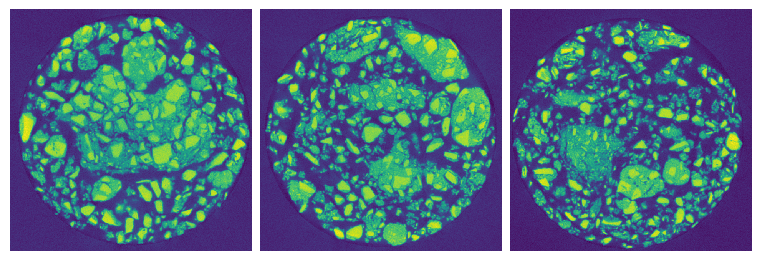

In [7]:
YAML_FILE = '../data/IDOX_EstaneNP/IDOX_EstaneNP.yml'
slices = [100, 450, 800]
#----------------------#
# Read YAML input file #
#----------------------#
# Load YAML inputs into a dictionary
ui = sf.load_inputs(YAML_FILE)
#-------------#
# Load images #
#-------------#
print()
imgs = sf.load_images(
    ui['ct_img_dir'],
    slice_crop=ui['slice_crop'],
    row_crop=ui['row_crop'],
    col_crop=ui['col_crop'],
    convert_to_float=True,
    file_suffix=ui['file_suffix']
)
fig, axes = sf.plot_imgs(
    imgs,
    # n_imgs=3,
    slices=slices,
    print_slices=True,
    imgs_per_row=None,
    fig_w=7.5,
    dpi=100
)

## Rescale intensities

Preprocessing images...
--> Applying median filter...
--> Rescaling intensities to percentile range [5, 95]...
--> Preprocessing complete
Plotting images: [100, 450, 800]


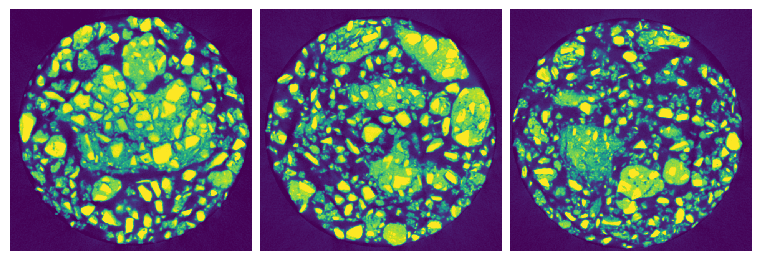

In [6]:
#-------------------#
# Preprocess images #
#-------------------#
imgs_pre = sf.preprocess(
    imgs, median_filter=ui['pre_seg_med_filter'],
    rescale_intensity_range=ui['rescale_range']
)
fig, axes = sf.plot_imgs(
    imgs_pre,
    # n_imgs=3,
    slices=slices,
    print_slices=True,
    imgs_per_row=None,
    fig_w=7.5,
    dpi=100
)

Plotting images: [0, 112, 224, 336, 448, 560, 672, 784, 896]


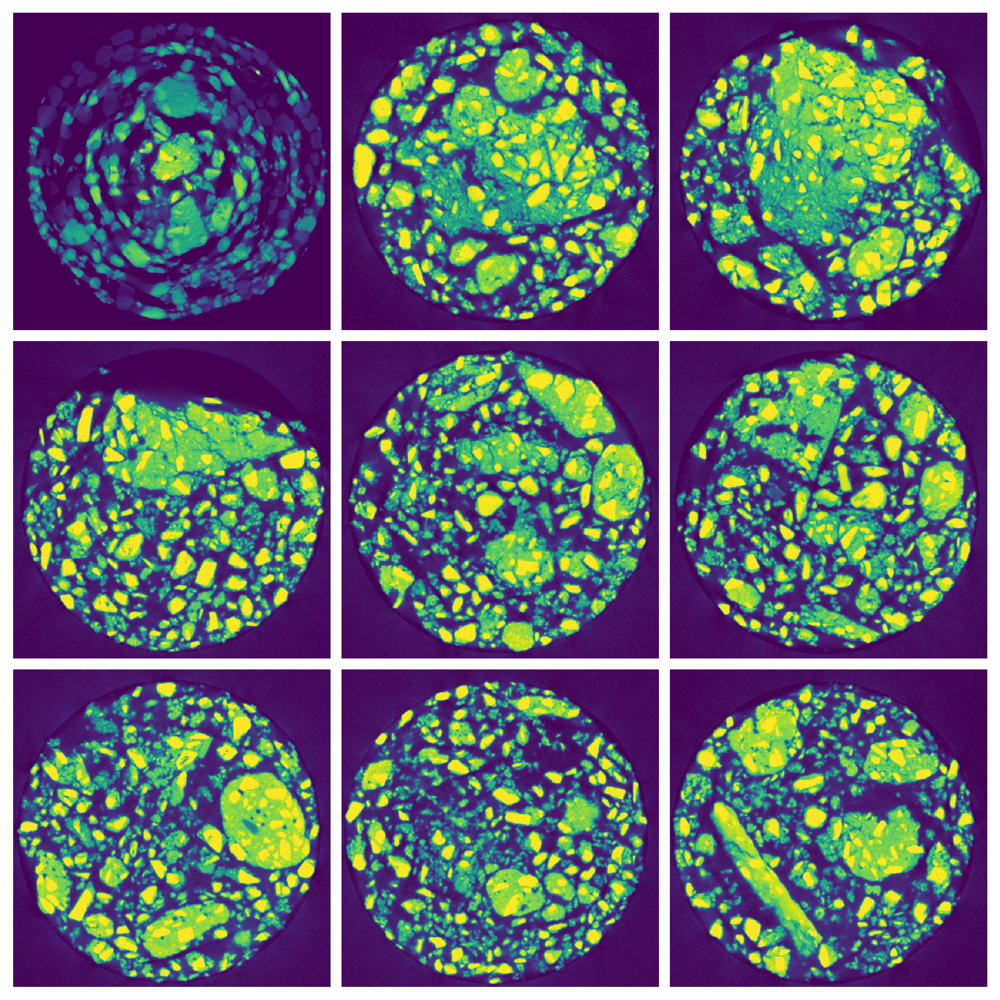

In [7]:
fig, axes = sf.plot_imgs(
    imgs_pre,
    n_imgs=9,
    slices=None,
    print_slices=True,
    imgs_per_row=3,
    fig_w=7.5,
    dpi=300
)

## Binarization

Binarizing images...
--> Calculating Otsu threshold(s)...
--> Binarization complete.
Plotting images: [100, 450, 800]


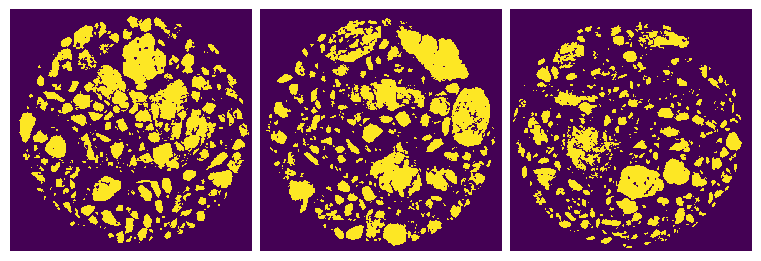

In [8]:
#-----------------#
# Binarize images #
#-----------------#
imgs_binarized, thresh_vals = sf.binarize_multiotsu(
    imgs_pre,
    n_otsu_classes=ui['n_otsu_classes'],
    downsample_image_factor=ui['downsample_factor'],
    n_selected_thresholds=ui['n_selected_classes'],
)
fig, axes = sf.plot_imgs(
    imgs_binarized,
    # n_imgs=3,
    slices=slices,
    print_slices=True,
    imgs_per_row=None,
    fig_w=7.5,
    dpi=100
)

In [9]:
print(thresh_vals)

[18324 44083]


18324
127
44083
255
Plotting images: [100, 450, 800]


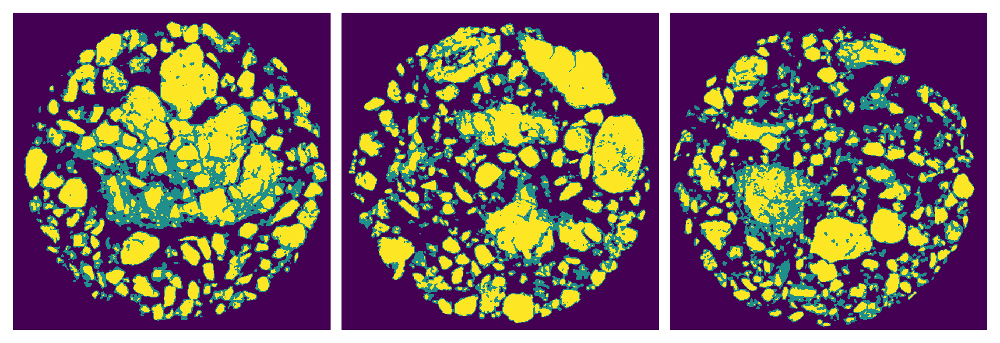

In [10]:
# Sort thresh_vals in ascending order then reverse to get largest first
thresh_vals.sort()
isolated_classes = np.zeros_like(imgs, dtype=np.uint8)
# Starting with the lowest threshold value, set pixels above each
# increasing threshold value to an increasing unique marker (1, 2, etc.)
intensity_step = 255 / len(thresh_vals)
for i, val in enumerate(thresh_vals):
    print(val)
    intensity = int((i + 1) * intensity_step)
    print(intensity)
    isolated_classes[imgs_pre > val] = int((i + 1) * intensity_step)
if ui['save_classes']:
    sf.save_isolated_classes(imgs_pre, thresh_vals, ui['stl_dir_location'])
fig, axes = sf.plot_imgs(
    isolated_classes,
    # n_imgs=9,
    slices=slices,
    print_slices=True,
    imgs_per_row=3,
    fig_w=7.5,
    dpi=300
)

## Segmentation

In [11]:
#----------------#
# Segment images #
#----------------#
if ui['perform_seg']:
    print()
    segment_dict = sf.watershed_segment(
        imgs_binarized, min_peak_distance=ui['min_peak_dist'],
        use_int_dist_map=ui['use_int_dist_map'],
        exclude_borders=ui['exclude_borders'], return_dict=True
    )


Segmenting images...
--> Number of particle(s) before border exclusion:  15349
--> Excluding border particles...
--> Segmentation complete. 15193 particle(s) segmented.


TypeError: plot_instance_seg() got an unexpected keyword argument 'print_slices'

Plotting images: [100, 450, 800]


AttributeError: 'numpy.ndarray' object has no attribute 'imshow'

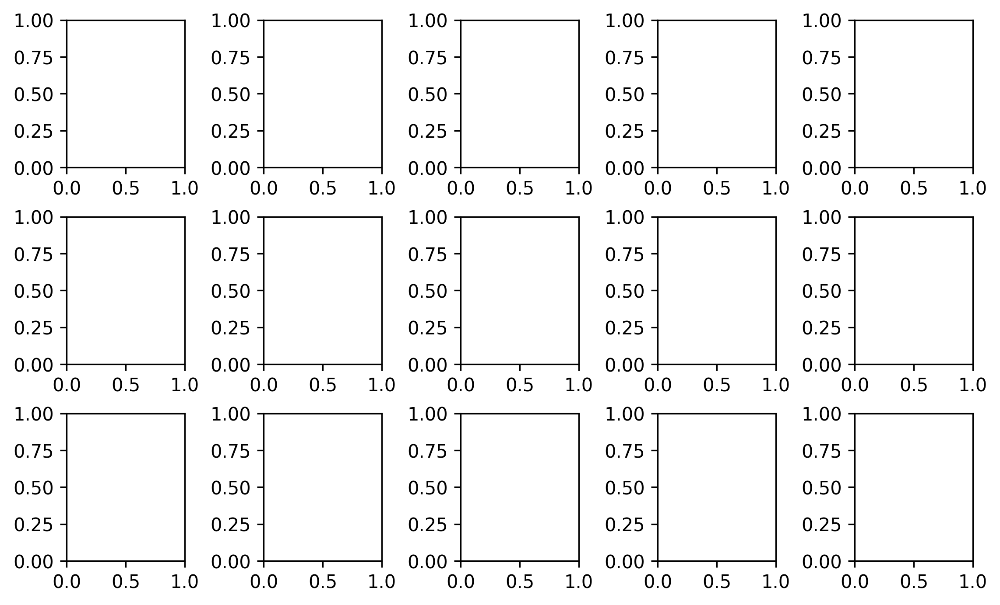

In [16]:
fig, axes = sf.plot_instance_seg(
    segment_dict['integer-labels'],
    # n_imgs=9,
    slices=slices,
    fig_w=7.5,
    dpi=300
)

In [ ]:
#-------------------------#
# Plot figures if enabled #
#-------------------------#
if ui['seg_fig_show']:
    fig_seg_steps, axes_seg_steps = sf.plot_segment_steps(
            imgs, imgs_pre, imgs_binarized, segment_dict,
            n_imgs=ui['seg_fig_n_imgs'], slices=ui['seg_fig_slices'],
            plot_maxima=ui['seg_fig_plot_max'])
if ui['label_fig_show']:
    fig_labels, ax_labels = sf.plot_particle_labels(
            segment_dict, ui['label_fig_idx'])
if ui['stl_fig_show']:
    fig_stl, ax_stl = sf.plot_stl(ui['stl_dir_location'])
if ui['seg_fig_show'] or ui['label_fig_show'] or ui['stl_fig_show']:
    plt.show()